<a href="https://colab.research.google.com/github/mjhoover1/autoencoders/blob/main/CIFAR_10/experiments/CIFAR10_ModVAE_latent_times_16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import sklearn
import tensorflow as tf
from tensorflow import keras
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
import os
from keras.layers import *

from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from sklearn.model_selection import train_test_split

In [2]:
def test_and_train_model(normals, abnormals, results_dir):
    (x_train_0, y_train_0), (x_test, y_test) = keras.datasets.cifar10.load_data()

    x_train_0 = x_train_0.astype(np.float32) / 255
    x_test = x_test.astype(np.float32) / 255

    train_size = x_train_0.shape[0] * 9 // 10

    x_train, x_valid, y_train, y_valid = train_test_split(x_train_0, y_train_0, train_size = train_size)

    normal_data = x_train[np.isin(y_train, normals).flatten()]    # Normal training data (Normal digits)
    normal_labels = y_train[np.isin(y_train, normals).flatten()]  

    valid_data = x_valid[np.isin(y_valid, abnormals).flatten() | np.isin(y_valid, normals).flatten()]    # Validation data (both normal digits and the abnormal digit)
    valid_labels = y_valid[np.isin(y_valid, abnormals).flatten() | np.isin(y_valid, normals).flatten()]

    test_data = x_test[np.isin(y_test, abnormals).flatten() | np.isin(y_test, normals).flatten()]   # Test data (both normal digits and the abnormal digit)
    test_labels = y_test[np.isin(y_test, abnormals).flatten() | np.isin(y_test, normals).flatten()]

    test_labels_T_F = np.where(np.isin(test_labels, normals).flatten(), True, False) 
    # Array of T and F, T where test digits are normal and F where test digits are abnormal

    valid_labels_T_F = np.where(np.isin(valid_labels, normals).flatten(), True, False) 
    # Array of T and F, T where test digits are normal and F where test digits are abnormal

    normal_data.shape, normal_labels.shape, valid_data.shape, valid_labels.shape, test_data.shape, test_labels.shape

    normal_test_data = test_data[np.isin(test_labels, normals).flatten()]   # The normal digits in the test data
    abnormal_test_data = test_data[np.isin(test_labels, abnormals).flatten()]                          # The abnormal digits in the test data
    normal_test_labels = test_labels[np.isin(test_labels, normals).flatten()]   # Their labels
    abnormal_test_labels = test_labels[np.isin(test_labels, abnormals).flatten()]                          # Their labels

    normal_test_data.shape, abnormal_test_data.shape

    normal_valid_data = valid_data[np.isin(valid_labels, normals).flatten()]   # The normal digits in the valid data
    abnormal_valid_data = valid_data[np.isin(valid_labels, abnormals).flatten()]                           # The abnormal digits in the valid data
    normal_valid_labels = valid_labels[np.isin(valid_labels, normals).flatten()]   # Their labels
    abnormal_valid_labels = valid_labels[np.isin(valid_labels, abnormals).flatten()]                           # Their labels

    normal_valid_data.shape, abnormal_valid_data.shape

    """### **Building and training the network** """
    K = keras.backend

    # Modified sampling layer with the addition of mean_2, log_var_2, and fraction p, with
    # the appropriate change in the reparametrization trick to do stochastic 
    # sampling from the superposition of the two MVN distributions, while allowing
    # the 5 parallel layers containing the means and stds of the two MVNs and the fractions p's
    # for each dimension to be trained via backpropogation of the error signal.
    class Sampling(keras.layers.Layer):
        def call(self, inputs):
            mean_1, log_var_1, mean_2, log_var_2, p = inputs
            return (K.random_normal(tf.shape(log_var_1)) * K.exp(log_var_1 / 2) + mean_1)*p + (K.random_normal(tf.shape(log_var_2)) * K.exp(log_var_2 / 2) + mean_2)*(1 - p)
    
    # For details please see Geron's book. 
    codings_size = 16   # The number of dimensions of the MVN distribution in the sampling layer

    # inputs = keras.layers.Input(shape=[32, 32, 3])
    # z = keras.layers.Flatten()(inputs)
    # z = keras.layers.Dense(256, activation="selu")(z)
    # z = keras.layers.Dense(128, activation="selu")(z)
    # z = keras.layers.Dense(64, activation="selu")(z)

    inputs = keras.layers.Input(shape=[32, 32, 3])
    # z = keras.layers.Flatten()(inputs)
    # z = keras.layers.Dense(128, activation="selu")(z)
    #z = keras.layers.Reshape((257, 97, 1)), 
    z = Conv2D(64, (3, 3), padding='same')(inputs)
    z = Conv2D(64, (3, 3), padding='same')(z)
    # z = BatchNormalization(z)
    z = Activation('relu')(z)
    z = MaxPooling2D((2, 2), padding='same')(z)
    z = Conv2D(32, (3, 3), padding='same')(z)
    z = Conv2D(32, (3, 3), padding='same')(z)
    # z = BatchNormalization(z)
    z = Activation('relu')(z)
    z = MaxPooling2D((2, 2), padding='same')(z)
    z = keras.layers.Flatten()(z)

    # Adding output nodes (parallel layers) at the end of the encoder for means 
    # and standard deviations of a second Multivariate Normal (MVN) distribution 
    # in the dimensions of the coding size (here 32). In each of the dimensions,
    # this first MVN is multiplied by a fraction p and added to the second MVN
    # multiplied by 1 - p in each dimension.
    # final distribution = p * first MVN + (1 - p) * second MVN
    # Another parallel layer (set of nodes) is added to keep and train the fractions p's
    # in each dimension 
    codings_mean_1 = keras.layers.Dense(codings_size)(z)
    codings_log_var_1 = keras.layers.Dense(codings_size)(z)
    codings_mean_2 = keras.layers.Dense(codings_size)(z)
    codings_log_var_2 = keras.layers.Dense(codings_size)(z)
    codings_p = keras.layers.Dense(1, activation='sigmoid')(z)

    # Modified sampling layer at the end of the encoder
    codings = Sampling()([codings_mean_1, codings_log_var_1, codings_mean_2, codings_log_var_2, codings_p])
    variational_encoder = keras.models.Model(
        inputs=[inputs], outputs=[codings_mean_1, codings_log_var_1, codings_mean_2, codings_log_var_2, codings_p, codings])

    decoder_inputs = keras.layers.Input(shape=[codings_size])

    # tf.keras.layers.InputLayer(input_shape=(latent_dim,)),
    #            tf.keras.layers.Dense(units=7*7*32, activation=tf.nn.relu),
    #            tf.keras.layers.Reshape(target_shape=(7, 7, 32))

    x = keras.layers.Dense(units=8*8*32, activation="relu")(decoder_inputs)
    x = keras.layers.Reshape(target_shape=(8, 8, 32))(x)
    x = Conv2D(32, (3, 3), padding='same')(x)
    x = Conv2D(32, (3, 3), padding='same')(x)
    # x = BatchNormalization(x)
    x = Activation('relu')(x)
    x = UpSampling2D((2,2))(x)

    x = Conv2D(64, (3, 3), padding='same')(x)
    x = Conv2D(64, (3, 3), padding='same')(x)
    # x = BatchNormalization(x)
    x = Activation('relu')(x)
    x = UpSampling2D((2,2))(x)
    # x = keras.layers.Dense(128, activation="selu")(x)
    # x = keras.layers.Dense(32 * 32 * 3, activation="sigmoid")(x)
    x = Conv2D(3, (3, 3), padding='same')(x)
    x = Conv2D(3, (3, 3), padding='same')(x)
    # x = BatchNormalization(x)
    x = Activation('sigmoid')(x)
    outputs = keras.layers.Reshape([32, 32, 3])(x)

    # x = keras.layers.Dense(64, activation="selu")(decoder_inputs)
    # x = keras.layers.Dense(128, activation="selu")(x)
    # x = keras.layers.Dense(256, activation="selu")(x)
    # x = keras.layers.Dense(32 * 32 * 3, activation="sigmoid")(x)
    # outputs = keras.layers.Reshape([32, 32, 3])(x)
    variational_decoder = keras.models.Model(inputs=[decoder_inputs], outputs=[outputs])

    _, _, _, _, _, codings = variational_encoder(inputs)
    reconstructions = variational_decoder(codings)
    variational_ae = keras.models.Model(inputs=[inputs], outputs=[reconstructions])

    # New latent loss function that will be added to the reconstruction binary cross-entropy loss
    # The whole network (Encoder, sampling layer, and decoder) will train to minimize this loss
    p_mean = K.mean(codings_p)
    array1 = p_mean*(codings_log_var_1 - K.exp(codings_log_var_1) - K.square(codings_mean_1))
    array2 = (1-p_mean)*(codings_log_var_2 - K.exp(codings_log_var_2) - K.square(codings_mean_2))
    sum1 = K.sum(1 + array1, axis=-1)
    sum2 = K.sum(1 + array2, axis=-1)

    latent_loss = -0.5 * (sum1 + sum2)

    latent_loss = latent_loss * 16

    # Add the latent loss to the reconstruction loss
    variational_ae.add_loss(K.mean(latent_loss) / 784.)

    # For the reconstruction loss binary cross-entropy loss is used (same as regular VAE). 
    # For details please see Chapter 17 of Geron's book (Stacked AE and VAE sections) 
    variational_ae.compile(loss="binary_crossentropy", optimizer="rmsprop")

    checkpoint_cb = keras.callbacks.ModelCheckpoint("modVAE_latent_times_16_model", monitor="val_loss", save_best_only=True)

    history = variational_ae.fit(normal_data, normal_data, epochs=100, batch_size=128, callbacks=[checkpoint_cb],
                                validation_data=(normal_valid_data, normal_valid_data), shuffle=True)



    
    plt.plot(history.history["loss"], label="Training Loss")
    plt.plot(history.history["val_loss"], label="Validation Loss")
    plt.legend()
    plt.savefig(os.path.join(results_dir, 'loss_history.png'))
    plt.close()

    model = variational_ae
    model.summary(expand_nested=True, show_trainable=True)

    model_encoder = variational_encoder
    # model_encoder.summary(expand_nested=True, show_trainable=True)

    model_decoder = variational_decoder
    # model_decoder.summary(expand_nested=True, show_trainable=True)

    model_layers = np.array(model.layers)
    n_layers = model_layers.shape[0] 
    # np.concatenate((np.arange(n_layers).reshape(n_layers,1), model_layers.reshape(n_layers,1)), axis = 1)

    """### **The original and reconstructed images for the first 30 instances of the normal training data, validation data, normal validation data, abnormal validation data, test data, normal test data, and abnormal test data**"""

    def plot_image(image):
        plt.imshow(image, cmap="binary")
        plt.axis("off")

    def show_reconstructions(model, images, n_images=5):
        reconstructions = model.predict(images[:n_images])
        fig = plt.figure(figsize=(n_images * 1.5, 3))
        for image_index in range(n_images):
            plt.subplot(2, n_images, 1 + image_index)
            plot_image(images[image_index])
            plt.subplot(2, n_images, 1 + n_images + image_index)
            plot_image(reconstructions[image_index])

    show_reconstructions(variational_ae, normal_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_normal.png'))
    plt.close()

    show_reconstructions(variational_ae, valid_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_valid.png'))
    plt.close()

    show_reconstructions(variational_ae, normal_valid_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_normal_valid.png'))
    plt.close()

    show_reconstructions(variational_ae, abnormal_valid_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_abnormal_valid.png'))
    plt.close()

    show_reconstructions(variational_ae, test_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_test.png'))
    plt.close()

    show_reconstructions(variational_ae, normal_test_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_normal_test.png'))
    plt.close()

    show_reconstructions(variational_ae, abnormal_test_data, 30)
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstructions_abnormal_test.png'))
    plt.close()

    """**1-Dim plot of pixels of the first normal test data**"""

    reconstructions_nl_test = variational_ae.predict(normal_test_data)

    plt.figure(figsize=(25,7))
    plt.plot(normal_test_data[0].ravel(), 'r')
    plt.plot(reconstructions_nl_test[0].ravel(), 'g')
    plt.fill_between(np.arange(32*32*3), reconstructions_nl_test[0].ravel(), normal_test_data[0].ravel(), color='blue')
    plt.legend(labels=["Input", "Reconstruction", "Error"])
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstruction_error_normal.png'))
    plt.close()

    """**1-Dim plot of pixels of the first abnormal test data**"""

    reconstructions_nl_test = variational_ae.predict(normal_test_data)
    
    plt.figure(figsize=(25,7))
    plt.plot(normal_test_data[0].ravel(), 'r')
    plt.plot(reconstructions_nl_test[0].ravel(), 'g')
    plt.fill_between(np.arange(32*32*3), reconstructions_nl_test[0].ravel(), normal_test_data[0].ravel(), color='blue')
    plt.legend(labels=["Input", "Reconstruction", "Error"])
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstruction_error_normal.png'))
    plt.close()

    """### **Distributions of the reconstruction losses and the calculation of the threshold.**

    **Distribution of the reconstruction losses of the normal training data**
    """
    reconstructions = variational_ae.predict(normal_data)
    train_loss = tf.keras.losses.mae(reconstructions.reshape(-1, 3072), normal_data.reshape(-1, 3072))
    plt.figure(figsize=(10,5))
    plt.hist(train_loss[None,:], bins=100)
    threshold1 = np.mean(train_loss) + 2.5*np.std(train_loss)
    plt.axvline(threshold1,c='g')
    plt.xlabel("MAE reconstruction loss of the normal training data")
    plt.ylabel("No of examples")
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstruction_losses_normal.png'))
    plt.close()

    print("Mean: ", np.mean(train_loss))
    print("Std: ", np.std(train_loss))

    threshold_train_mean_2_5_std = np.mean(train_loss) + 2.5*np.std(train_loss)
    print("Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std: ", threshold_train_mean_2_5_std)

    threshold1 = threshold_train_mean_2_5_std

    """**Distribution of the reconstruction losses of the abnormal validation data**"""
    reconstructions = variational_ae.predict(abnormal_valid_data)
    abn_valid_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), abnormal_valid_data.reshape(-1,3072))
    plt.figure(figsize=(10,5))
    plt.hist(abn_valid_loss[None, :], bins=100)
    threshold2 = np.mean(abn_valid_loss) - np.std(abn_valid_loss)
    plt.axvline(threshold2,c='cyan')
    plt.axvline(threshold1,c='g')
    plt.xlabel("MAE reconstruction loss of the abnormal validation data")
    plt.ylabel("No of examples")
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstruction_loss_abnormal_validation_data.png'))
    plt.close()

    abnormal_valid_mean_loss = np.mean(abn_valid_loss)

    abnormal_valid_mean_loss , np.std(abn_valid_loss)

    threshold2 = abnormal_valid_mean_loss - np.std(abn_valid_loss)
    print("Threshold2: ", threshold2)

    """**Distribution of the reconstruction losses of the normal validation data**"""

    reconstructions = variational_ae.predict(normal_valid_data)
    nl_valid_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), normal_valid_data.reshape(-1,3072))
    plt.figure(figsize=(10,5))
    plt.hist(nl_valid_loss[None, :], bins=100)
    threshold3 = np.mean(nl_valid_loss) + np.std(nl_valid_loss)
    plt.axvline(threshold3, c='magenta')
    plt.axvline(threshold2, c='cyan')
    plt.axvline(threshold1, c='g')
    plt.xlabel("MAE reconstruction loss of the normal validation data")
    plt.ylabel("No of examples")
    plt.show()

    normal_valid_mean_loss = np.mean(nl_valid_loss)
    normal_valid_mean_loss , np.std(nl_valid_loss)

    threshold3 = normal_valid_mean_loss + np.std(nl_valid_loss)
    print("Threshold3: ", threshold3)

    """**Calculation of a preliminary threshold based on (threshold2 + threshold3) / 2 = Average of (mean + std of the distribution of the reconstruction losses of the normal validation data) and (mean - std of the distribution of the reconstruction losses of the abnormal validation data)**"""

    Avg_of_threshold_2_3 = (threshold2 + threshold3)/2
    print("Average of threshold 2 and 3: ", Avg_of_threshold_2_3)

    threshold4 = Avg_of_threshold_2_3

    """### **Calculation of the threshold that gives the best accuracy on the validation data and set this as the threshold.**"""

    def predict(model, data, threshold):
      reconstructions = model.predict(data)
      loss = tf.keras.losses.mae(reconstructions.reshape(-1, 3072), data.reshape(-1, 3072))
      return tf.math.less(loss, threshold)

    increment = (abnormal_valid_mean_loss- normal_valid_mean_loss)/100
    thresholds = np.arange(normal_valid_mean_loss, abnormal_valid_mean_loss, increment)
    thrs_size = thresholds.shape[0]
    accuracies = np.zeros(thrs_size)
    for i in range(thrs_size):
      preds = predict(variational_ae, valid_data, thresholds[i])
      accuracies[i] = accuracy_score(preds, valid_labels_T_F)
    argmax = np.argmax(accuracies)
    valid_data_best_threshold = thresholds[argmax]
    print("The best threshold based on validation data: ", valid_data_best_threshold)

    thr_acc = np.zeros((thrs_size, 2))
    thr_acc[:, 0] = thresholds
    thr_acc[:, 1] = accuracies
    thr_acc[argmax-2:argmax+3]

    threshold5 = valid_data_best_threshold

    threshold = threshold5

    """#### **Distribution of the reconstruction losses of all the validation data (normal and abnormal)**

    The blue line is threshold4 (= the average of threshold3 [magenta] and threshold2 [cyan]). 

    The red line is the threshold that gives the best accuracy for the validation data.
    """

    reconstructions = variational_ae.predict(valid_data)
    valid_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), valid_data.reshape(-1,3072))

    
    reconstructions = variational_ae.predict(valid_data)
    valid_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), valid_data.reshape(-1,3072))
    plt.figure(figsize=(20,5))
    plt.hist(valid_loss[None, :], bins=100)
    plt.axvline(threshold, c='r')
    plt.axvline(threshold4, c='b')
    plt.axvline(threshold2, c='cyan')
    plt.axvline(threshold3, c='magenta')
    plt.axvline(threshold1, c='green')
    plt.xlabel("MAE reconstruction loss of the validation data")
    plt.ylabel("No of examples")
    plt.show()
    plt.savefig(os.path.join(results_dir, 'reconstruction_loss_validation_data.png'))
    plt.close()

    """### **Mean and standard deviation of reconstruction losses for normal and abnormal test data"""
    reconstructions = variational_ae.predict(normal_test_data)
    nl_test_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), normal_test_data.reshape(-1,3072))
    np.mean(nl_test_loss) , np.std(nl_test_loss)

    reconstructions = variational_ae.predict(abnormal_test_data)
    abn_test_loss = tf.keras.losses.mae(reconstructions.reshape(-1,3072), abnormal_test_data.reshape(-1,3072))
    np.mean(abn_test_loss) , np.std(abn_test_loss)

    """### **Calculation of the accuracy and the confusion matrix on the test data with threshold set based on the best threshold from the validation data**"""

    def print_stats(predictions, labels):
      cf = confusion_matrix(labels, predictions)
      print("Confusion Matrix: \n prediction: F      T ")
      print("             {}   {}".format(preds[preds == False].shape[0], preds[preds == True].shape[0]))
      print(" label: F   [[{}   {}]    {}".format(cf[0,0], cf[0,1], test_labels_T_F[test_labels_T_F == False].shape[0]))
      print("        T    [{}   {}]]   {}".format(cf[1,0], cf[1,1], test_labels_T_F[test_labels_T_F == True].shape[0]))
      accuracy = accuracy_score(labels, predictions)
      print("Accuracy = {}".format(accuracy))
      normal_test_mean = np.mean(nl_test_loss)
      print("Normal Test Data Mean = {}".format(normal_test_mean))
      normal_test_stdev = np.std(nl_test_loss)
      print("Normal Test Data Standard Deviation = {}".format(normal_test_stdev))
      abnormal_test_mean = np.mean(abn_test_loss)
      print("Abnormal Test Data Mean = {}".format(abnormal_test_mean))
      abnormal_test_stdev = np.std(abn_test_loss)
      print("Abnormal Test Data Standard Deviation = {}".format(abnormal_test_stdev))
      precision = precision_score(labels, predictions)
      print("Precision = {}".format(precision))
      recall = recall_score(labels, predictions)
      print("Recall = {}".format(recall))
      return accuracy, normal_test_mean, normal_test_stdev, abnormal_test_mean, abnormal_test_stdev, precision, recall

    preds = predict(variational_ae, test_data, threshold)
    stats = print_stats(preds, test_labels_T_F)

    print("Threshold =", valid_data_best_threshold)

    print(confusion_matrix(test_labels_T_F, preds))

    # return only the item we need

    """#### **Extra accuracy info**
    **Just informative. Please record the above accuracy.**

    #### Accuracy on the test data with threshold set based on (threshold2 + threshold3) / 2 = Average of (mean + std of the distribution of the reconstruction losses of the normal validation data) and (mean - std of the distribution of the reconstruction losses of the abnormal validation data)
    """

    print("Extra results with different thresholds")

    preds = predict(variational_ae, test_data, Avg_of_threshold_2_3)
    print_stats(preds, test_labels_T_F)

    """#### Accuracy on the test data with threshold set based on the mean of the training data MAE reconstruction losses + 2.5 std"""

    preds = predict(variational_ae, test_data, threshold_train_mean_2_5_std)
    print_stats(preds, test_labels_T_F)

    return stats

In [3]:
def run_experiments(normals, abnormals):
  dirname = 'normals=' + ','.join(map(str,normals)) + ',abnormals=' + ','.join(map(str, abnormals))
  results_dir = os.path.join('VAE', dirname)
  if not os.path.isdir(results_dir):
    os.makedirs(results_dir)
  filename = os.path.join(results_dir, 'results.csv')
  res = np.empty([3,7])
  for i in range(1):
    print(i+1, 'out of', 3)
    loop_dir = os.path.join(results_dir, str(i))
    if not os.path.isdir(loop_dir):
      os.makedirs(loop_dir)
    res[i] = test_and_train_model(normals, abnormals, loop_dir)
  np.savetxt(filename, res, delimiter=',')
  return res

1 out of 3
170508288/170498071 [==============================] - 3s 0us/step
Epoch 1/100
36/36 [==============================] - 24s 281ms/step - loss: 0.5231 - val_loss: 0.5561
Epoch 2/100
36/36 [==============================] - 9s 248ms/step - loss: 0.5174 - val_loss: 0.5246
Epoch 3/100
36/36 [==============================] - 9s 244ms/step - loss: 0.5166 - val_loss: 0.5206
Epoch 4/100
36/36 [==============================] - 3s 94ms/step - loss: 0.5159 - val_loss: 0.5212
Epoch 5/100
36/36 [==============================] - 9s 243ms/step - loss: 0.5133 - val_loss: 0.5178
Epoch 6/100
36/36 [==============================] - 3s 95ms/step - loss: 0.5106 - val_loss: 0.5239
Epoch 7/100
36/36 [==============================] - 9s 243ms/step - loss: 0.5068 - val_loss: 0.5025
Epoch 8/100
36/36 [==============================] - 3s 94ms/step - loss: 0.5038 - val_loss: 0.5062
Epoch 9/100
36/36 [==============================] - 3s 94ms/step - loss: 0.5025 - val_loss: 0.5197
Epoch 10/100
36/

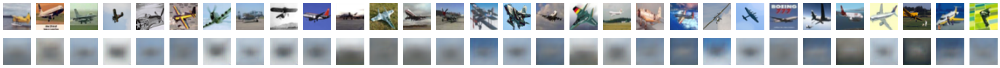

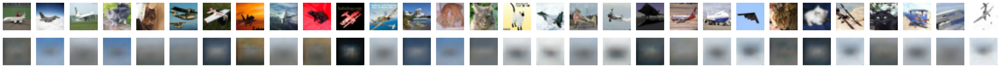

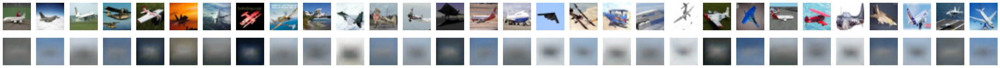

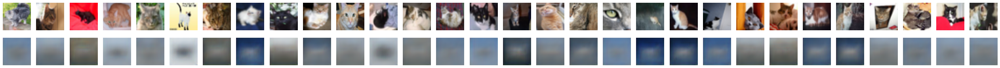

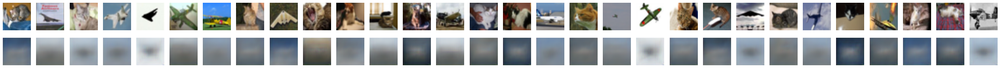

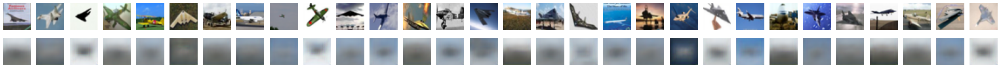

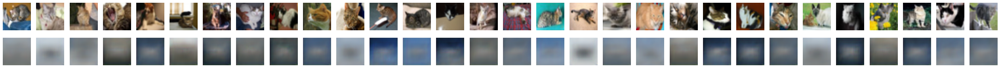

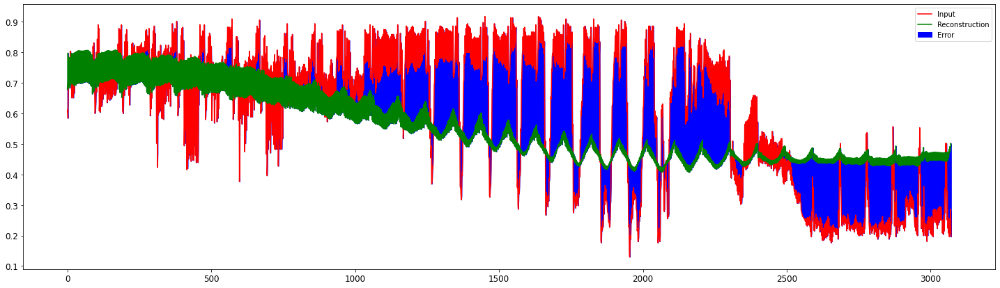

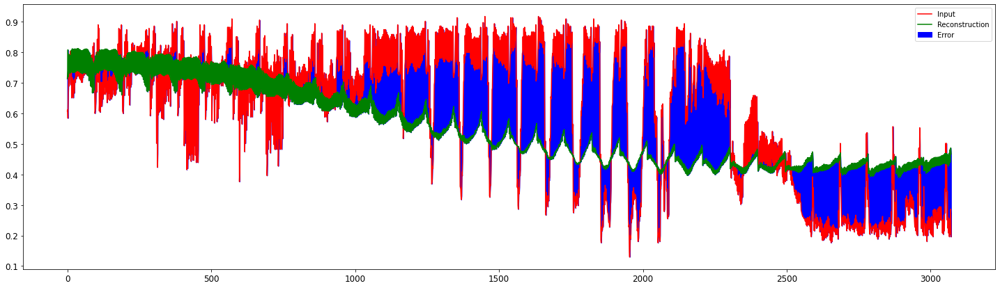

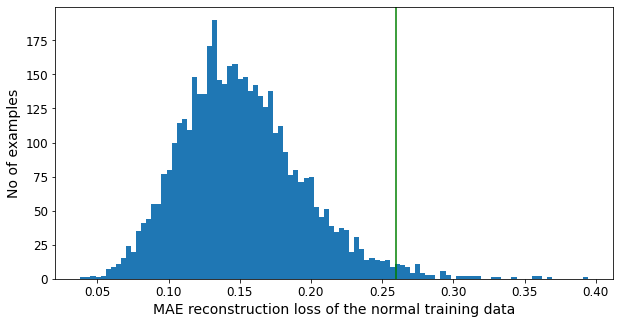

Mean:  0.15158497
Std:  0.043278005
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.2597799804061651


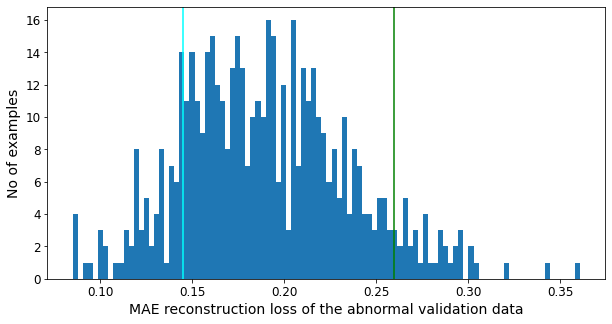

Threshold2:  0.14484611


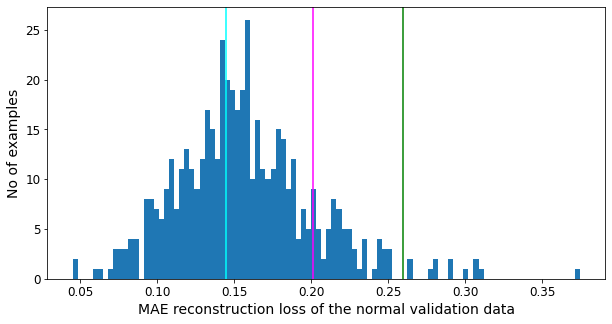

Threshold3:  0.20139831
Average of threshold 2 and 3:  0.17312221229076385
The best threshold based on validation data:  0.1608470928668977


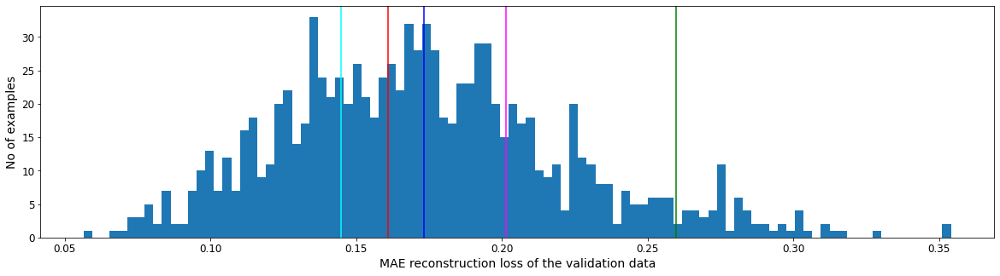

Confusion Matrix: 
 prediction: F      T 
             1074   926
 label: F   [[693   307]    1000
        T    [381   619]]   1000
Accuracy = 0.656
Normal Test Data Mean = 0.14944519102573395
Normal Test Data Standard Deviation = 0.042530614882707596
Abnormal Test Data Mean = 0.18592150509357452
Abnormal Test Data Standard Deviation = 0.04460727050900459
Precision = 0.6684665226781857
Recall = 0.619
Threshold = 0.1608470928668977
[[693 307]
 [381 619]]
Extra results with different thresholds
Confusion Matrix: 
 prediction: F      T 
             842   1158
 label: F   [[572   428]    1000
        T    [270   730]]   1000
Accuracy = 0.651
Normal Test Data Mean = 0.14944519102573395
Normal Test Data Standard Deviation = 0.042530614882707596
Abnormal Test Data Mean = 0.18592150509357452
Abnormal Test Data Standard Deviation = 0.04460727050900459
Precision = 0.6303972366148531
Recall = 0.73
Confusion Matrix: 
 prediction: F      T 
             77   1923
 label: F   [[63   937]    1000
  

In [4]:
normals = [0] # airplane
abnormals = [3] # cat
res1 = run_experiments(normals, abnormals)

1 out of 3
Epoch 1/100
36/36 [==============================] - 13s 274ms/step - loss: 0.5258 - val_loss: 0.5279
Epoch 2/100
36/36 [==============================] - 9s 241ms/step - loss: 0.5239 - val_loss: 0.5261
Epoch 3/100
36/36 [==============================] - 9s 242ms/step - loss: 0.5233 - val_loss: 0.5249
Epoch 4/100
36/36 [==============================] - 8s 232ms/step - loss: 0.5236 - val_loss: 0.5217
Epoch 5/100
36/36 [==============================] - 9s 246ms/step - loss: 0.5205 - val_loss: 0.5204
Epoch 6/100
36/36 [==============================] - 3s 97ms/step - loss: 0.5200 - val_loss: 0.5211
Epoch 7/100
36/36 [==============================] - 9s 243ms/step - loss: 0.5178 - val_loss: 0.5169
Epoch 8/100
36/36 [==============================] - 3s 94ms/step - loss: 0.5173 - val_loss: 0.5204
Epoch 9/100
36/36 [==============================] - 8s 233ms/step - loss: 0.5168 - val_loss: 0.5150
Epoch 10/100
36/36 [==============================] - 3s 94ms/step - loss: 0.5167

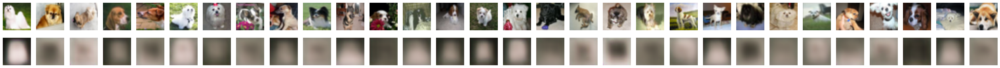

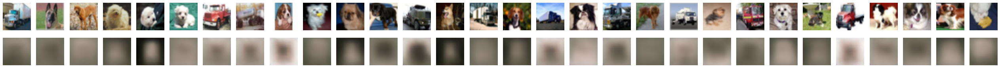

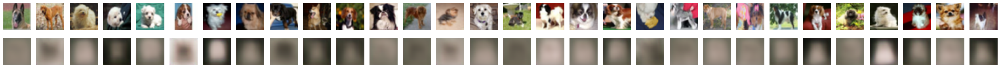

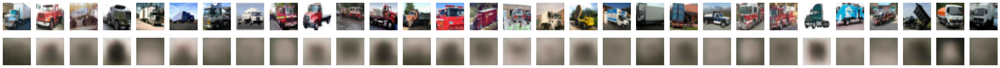

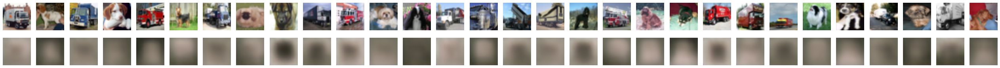

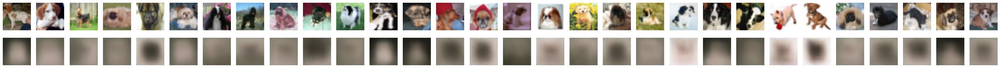

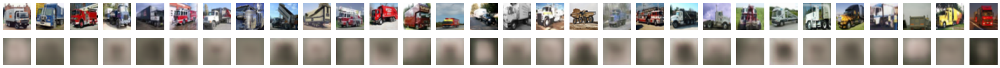

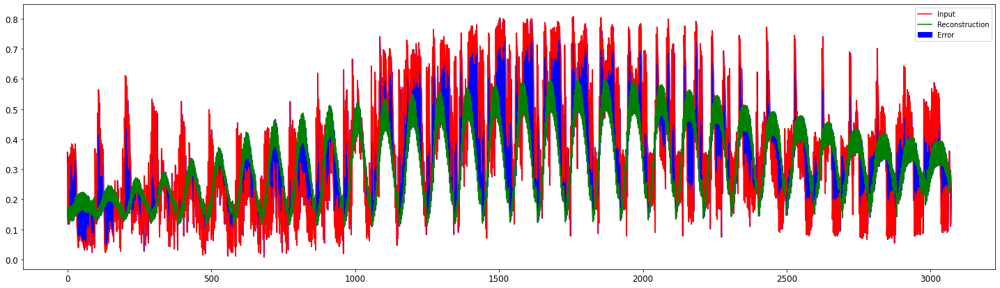

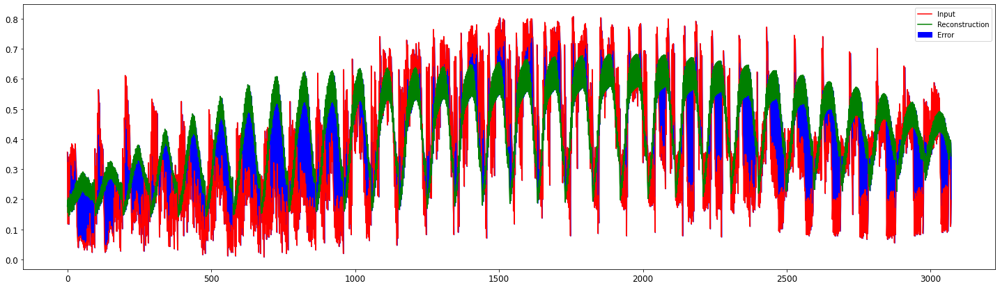

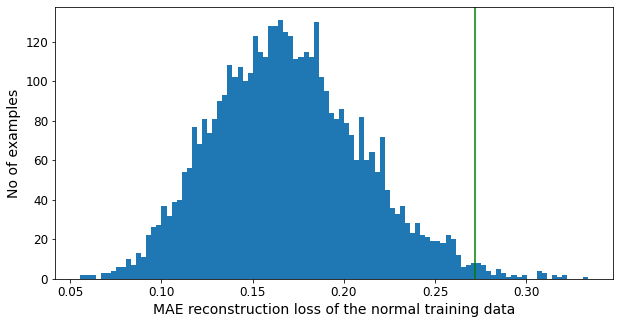

Mean:  0.16962661
Std:  0.041020874
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.27217879332602024


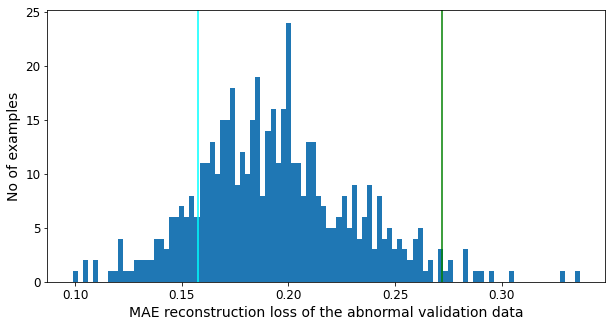

Threshold2:  0.15773761


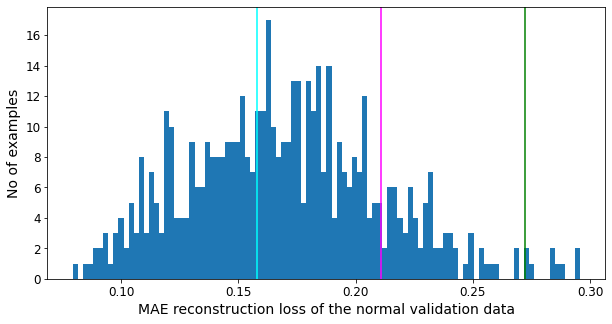

Threshold3:  0.2107664
Average of threshold 2 and 3:  0.18425200879573822
The best threshold based on validation data:  0.17275549650192265


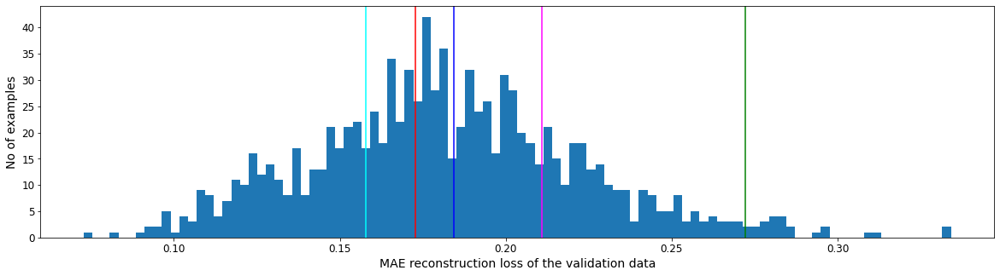

Confusion Matrix: 
 prediction: F      T 
             1193   807
 label: F   [[719   281]    1000
        T    [474   526]]   1000
Accuracy = 0.6225
Normal Test Data Mean = 0.17132915556430817
Normal Test Data Standard Deviation = 0.041694797575473785
Abnormal Test Data Mean = 0.19292500615119934
Abnormal Test Data Standard Deviation = 0.03421137109398842
Precision = 0.6517967781908303
Recall = 0.526
Threshold = 0.17275549650192265
[[719 281]
 [474 526]]
Extra results with different thresholds
Confusion Matrix: 
 prediction: F      T 
             953   1047
 label: F   [[585   415]    1000
        T    [368   632]]   1000
Accuracy = 0.6085
Normal Test Data Mean = 0.17132915556430817
Normal Test Data Standard Deviation = 0.041694797575473785
Abnormal Test Data Mean = 0.19292500615119934
Abnormal Test Data Standard Deviation = 0.03421137109398842
Precision = 0.603629417382999
Recall = 0.632
Confusion Matrix: 
 prediction: F      T 
             29   1971
 label: F   [[17   983]    1000

In [5]:
normals = [5] # dog
abnormals = [9] # truck
res2 = run_experiments(normals, abnormals)

1 out of 3
Epoch 1/100
36/36 [==============================] - 13s 267ms/step - loss: 0.5153 - val_loss: 0.5098
Epoch 2/100
36/36 [==============================] - 3s 93ms/step - loss: 0.5118 - val_loss: 0.5133
Epoch 3/100
36/36 [==============================] - 3s 93ms/step - loss: 0.5133 - val_loss: 0.5145
Epoch 4/100
36/36 [==============================] - 9s 241ms/step - loss: 0.5104 - val_loss: 0.5065
Epoch 5/100
36/36 [==============================] - 8s 239ms/step - loss: 0.5067 - val_loss: 0.5014
Epoch 6/100
36/36 [==============================] - 8s 232ms/step - loss: 0.5040 - val_loss: 0.4997
Epoch 7/100
36/36 [==============================] - 9s 245ms/step - loss: 0.5015 - val_loss: 0.4963
Epoch 8/100
36/36 [==============================] - 4s 97ms/step - loss: 0.4999 - val_loss: 0.5001
Epoch 9/100
36/36 [==============================] - 8s 236ms/step - loss: 0.4995 - val_loss: 0.4957
Epoch 10/100
36/36 [==============================] - 3s 93ms/step - loss: 0.4973 

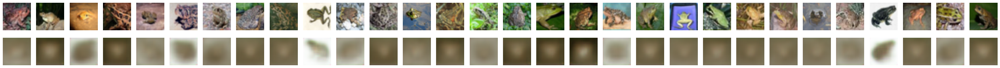

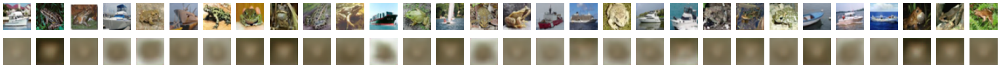

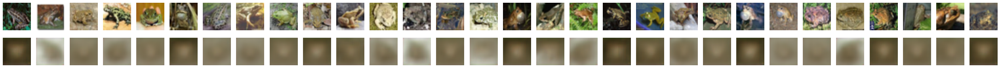

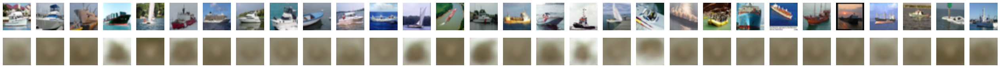

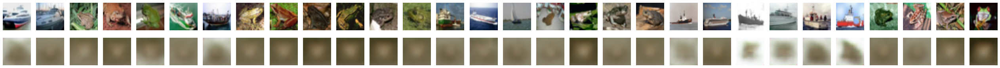

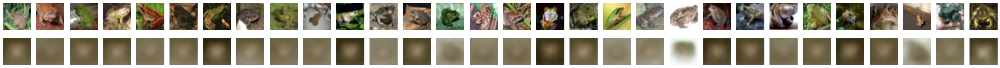

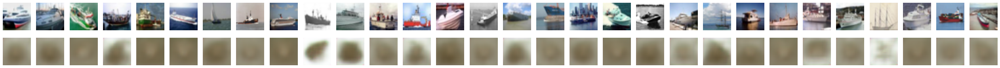

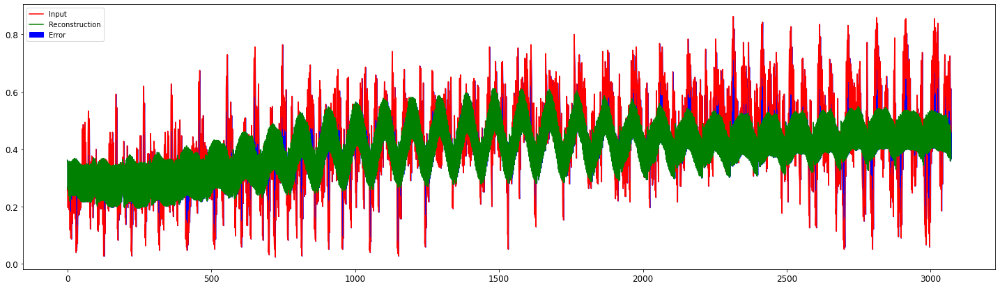

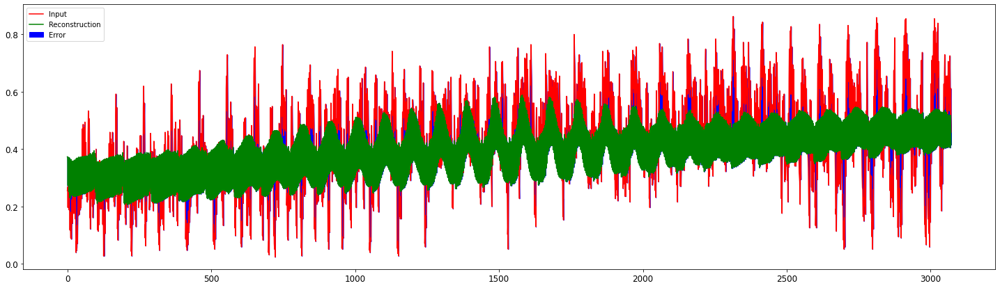

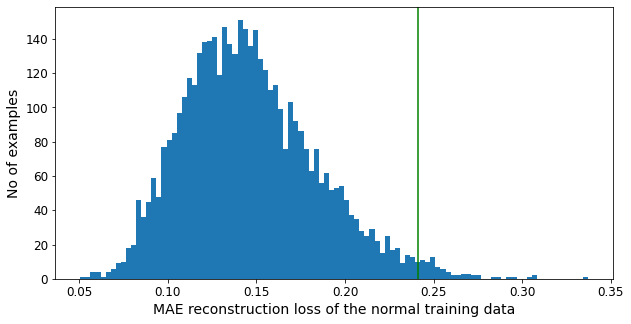

Mean:  0.14659356
Std:  0.03789717
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.24133647978305817


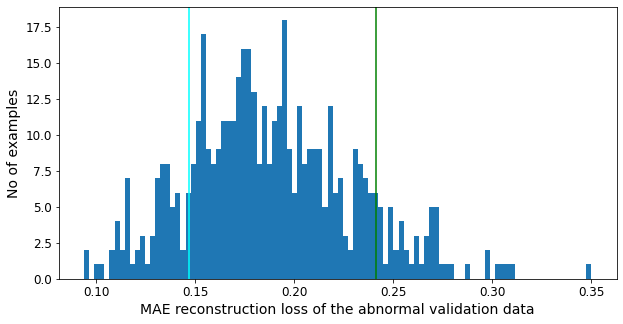

Threshold2:  0.14679812


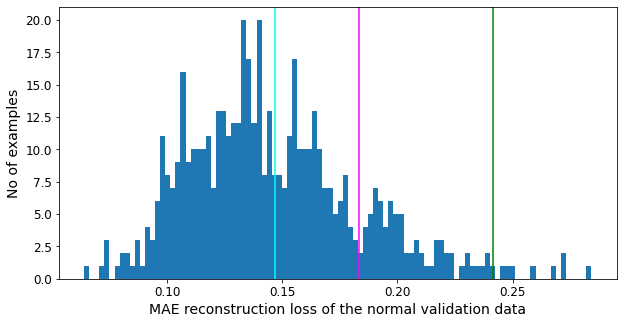

Threshold3:  0.18325868
Average of threshold 2 and 3:  0.1650283932685852
The best threshold based on validation data:  0.16210498601198192


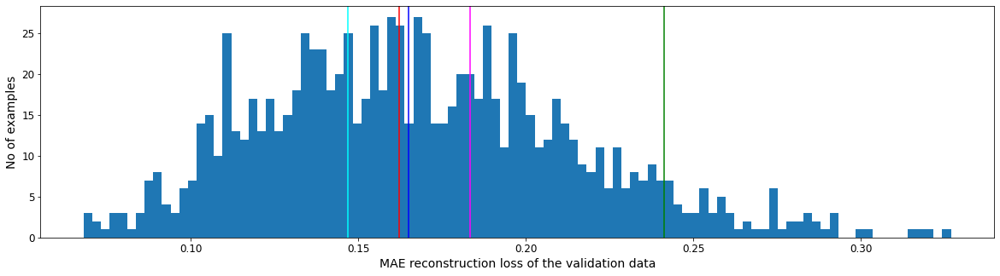

Confusion Matrix: 
 prediction: F      T 
             1007   993
 label: F   [[723   277]    1000
        T    [284   716]]   1000
Accuracy = 0.7195
Normal Test Data Mean = 0.14569689333438873
Normal Test Data Standard Deviation = 0.03770630061626434
Abnormal Test Data Mean = 0.18978089094161987
Abnormal Test Data Standard Deviation = 0.04157266020774841
Precision = 0.7210473313192346
Recall = 0.716
Threshold = 0.16210498601198192
[[723 277]
 [284 716]]
Extra results with different thresholds
Confusion Matrix: 
 prediction: F      T 
             957   1043
 label: F   [[700   300]    1000
        T    [257   743]]   1000
Accuracy = 0.7215
Normal Test Data Mean = 0.14569689333438873
Normal Test Data Standard Deviation = 0.03770630061626434
Abnormal Test Data Mean = 0.18978089094161987
Abnormal Test Data Standard Deviation = 0.04157266020774841
Precision = 0.7123681687440077
Recall = 0.743
Confusion Matrix: 
 prediction: F      T 
             130   1870
 label: F   [[114   886]    100

In [6]:
normals = [6] # frog
abnormals = [8] # ship
res3 = run_experiments(normals, abnormals)

1 out of 3
Epoch 1/100
71/71 [==============================] - 17s 194ms/step - loss: 0.5201 - val_loss: 0.5159
Epoch 2/100
71/71 [==============================] - 7s 96ms/step - loss: 0.5158 - val_loss: 0.5245
Epoch 3/100
71/71 [==============================] - 12s 163ms/step - loss: 0.5113 - val_loss: 0.5097
Epoch 4/100
71/71 [==============================] - 12s 169ms/step - loss: 0.5075 - val_loss: 0.5042
Epoch 5/100
71/71 [==============================] - 12s 165ms/step - loss: 0.5055 - val_loss: 0.5015
Epoch 6/100
71/71 [==============================] - 12s 169ms/step - loss: 0.5045 - val_loss: 0.5002
Epoch 7/100
71/71 [==============================] - 7s 95ms/step - loss: 0.5026 - val_loss: 0.5005
Epoch 8/100
71/71 [==============================] - 7s 95ms/step - loss: 0.5019 - val_loss: 0.5023
Epoch 9/100
71/71 [==============================] - 12s 169ms/step - loss: 0.5013 - val_loss: 0.4999
Epoch 10/100
71/71 [==============================] - 12s 168ms/step - loss: 

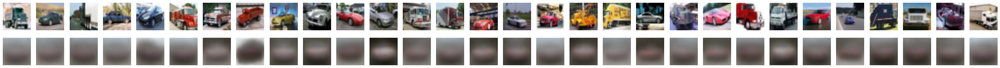

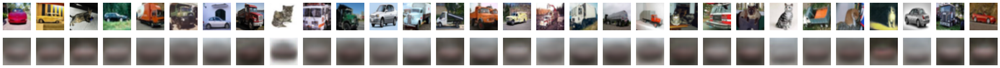

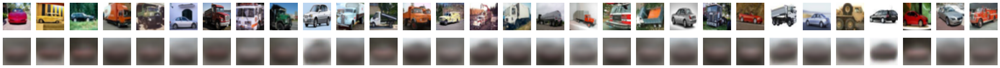

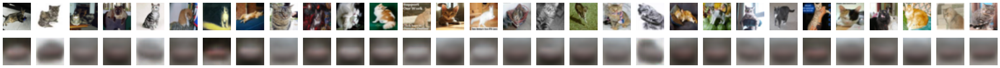

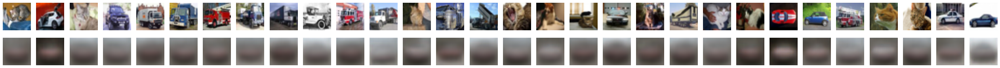

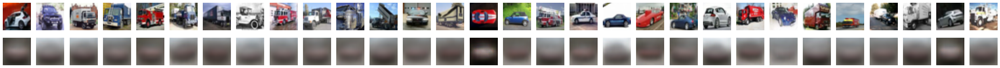

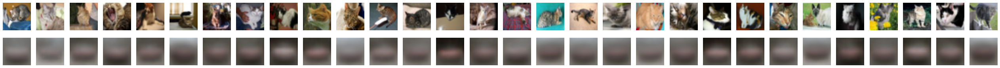

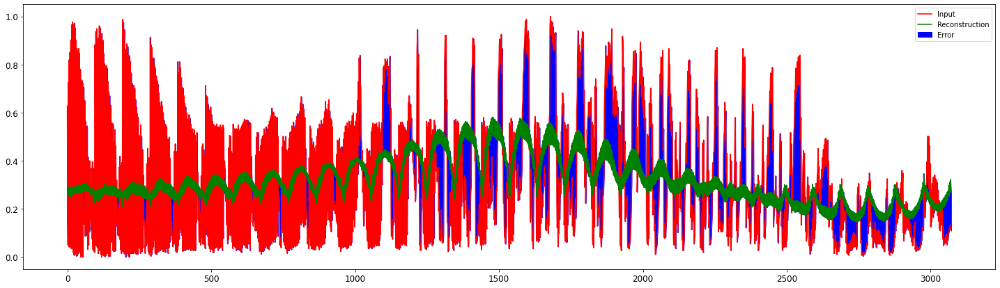

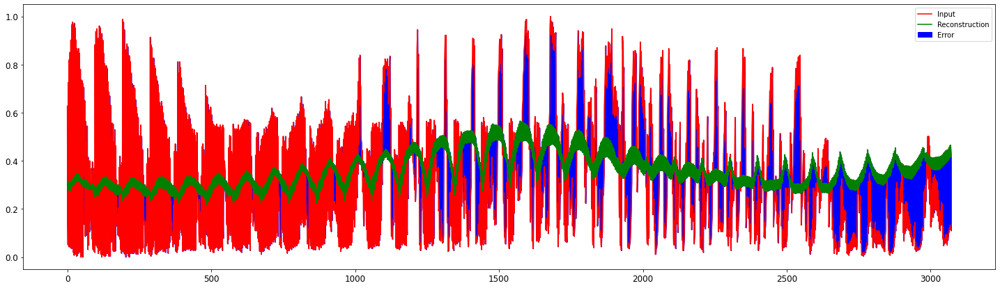

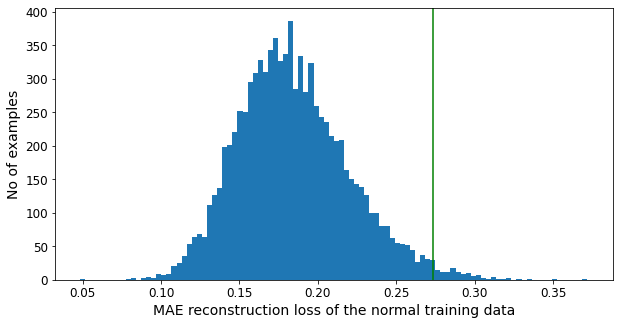

Mean:  0.18450531
Std:  0.035620984
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.273557772859931


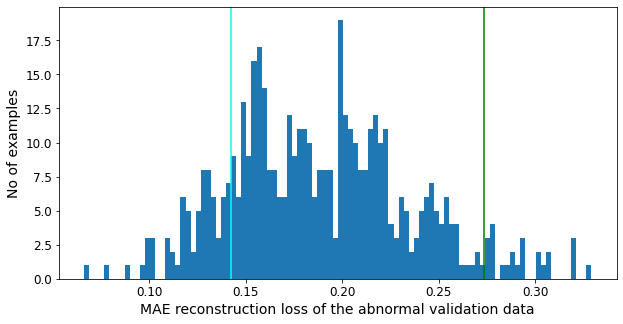

Threshold2:  0.14235929


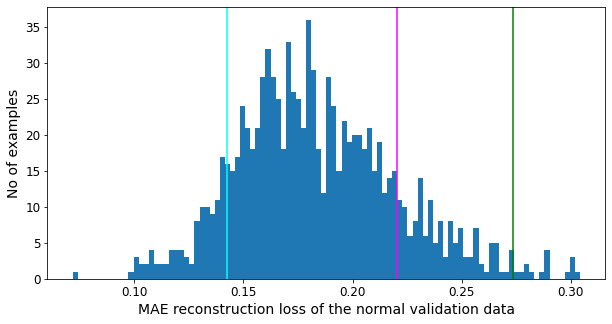

Threshold3:  0.22049852
Average of threshold 2 and 3:  0.1814289093017578
The best threshold based on validation data:  0.18838544964790355


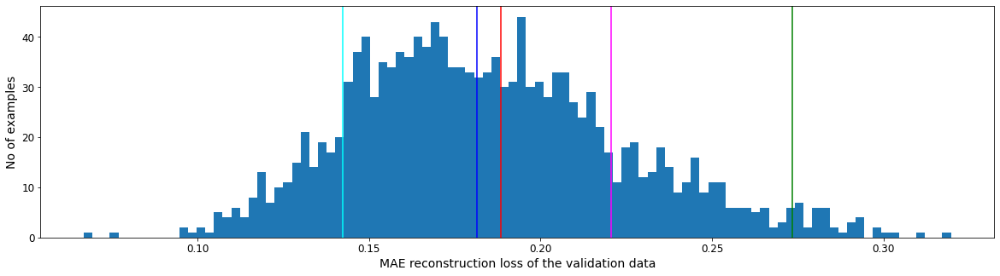

Confusion Matrix: 
 prediction: F      T 
             1293   1707
 label: F   [[447   553]    1000
        T    [846   1154]]   2000
Accuracy = 0.5336666666666666
Normal Test Data Mean = 0.18483120203018188
Normal Test Data Standard Deviation = 0.03607122227549553
Abnormal Test Data Mean = 0.18792349100112915
Abnormal Test Data Standard Deviation = 0.04644211381673813
Precision = 0.6760398359695372
Recall = 0.577
Threshold = 0.18838544964790355
[[ 447  553]
 [ 846 1154]]
Extra results with different thresholds
Confusion Matrix: 
 prediction: F      T 
             1498   1502
 label: F   [[510   490]    1000
        T    [988   1012]]   2000
Accuracy = 0.5073333333333333
Normal Test Data Mean = 0.18483120203018188
Normal Test Data Standard Deviation = 0.03607122227549553
Abnormal Test Data Mean = 0.18792349100112915
Abnormal Test Data Standard Deviation = 0.04644211381673813
Precision = 0.6737683089214381
Recall = 0.506
Confusion Matrix: 
 prediction: F      T 
             70   2930


In [7]:
normals = [1,9] # truck, automobile
abnormals = [3] # cat
res4 = run_experiments(normals, abnormals)

1 out of 3
Epoch 1/100
71/71 [==============================] - 16s 184ms/step - loss: 0.5262 - val_loss: 0.5243
Epoch 2/100
71/71 [==============================] - 12s 163ms/step - loss: 0.5241 - val_loss: 0.5221
Epoch 3/100
71/71 [==============================] - 12s 169ms/step - loss: 0.5217 - val_loss: 0.5171
Epoch 4/100
71/71 [==============================] - 12s 168ms/step - loss: 0.5186 - val_loss: 0.5136
Epoch 5/100
71/71 [==============================] - 12s 167ms/step - loss: 0.5160 - val_loss: 0.5129
Epoch 6/100
71/71 [==============================] - 12s 164ms/step - loss: 0.5148 - val_loss: 0.5102
Epoch 7/100
71/71 [==============================] - 7s 95ms/step - loss: 0.5129 - val_loss: 0.5174
Epoch 8/100
71/71 [==============================] - 12s 164ms/step - loss: 0.5120 - val_loss: 0.5088
Epoch 9/100
71/71 [==============================] - 12s 168ms/step - loss: 0.5110 - val_loss: 0.5060
Epoch 10/100
71/71 [==============================] - 12s 168ms/step - lo

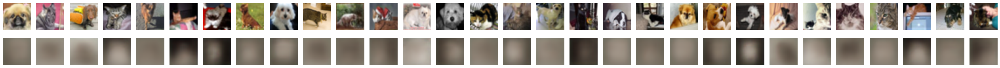

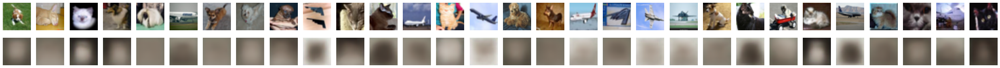

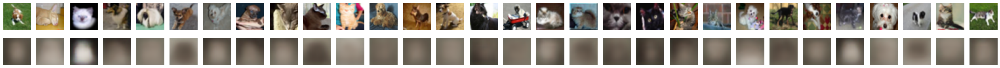

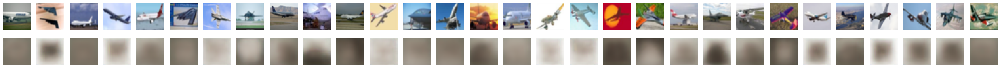

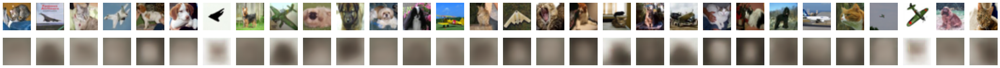

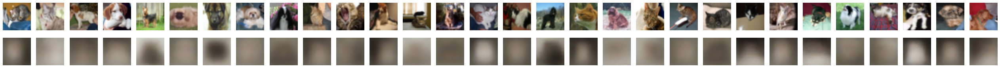

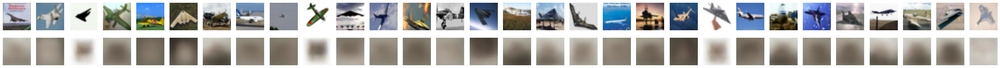

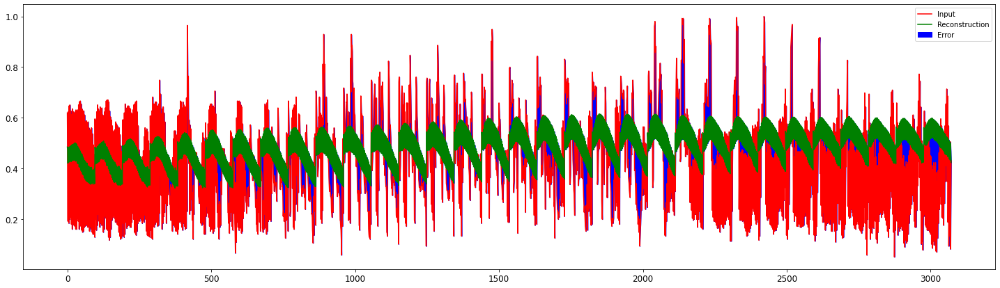

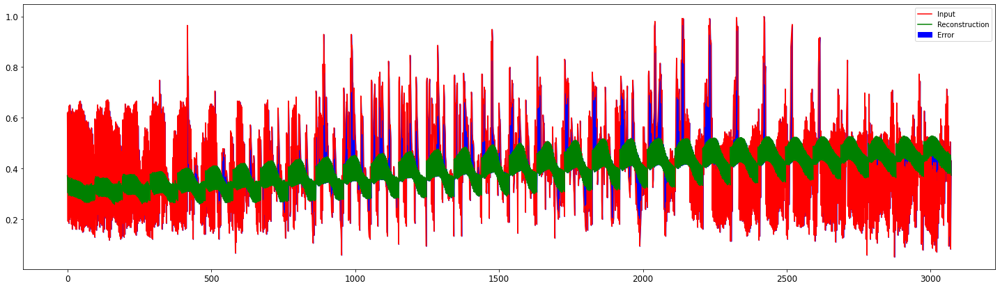

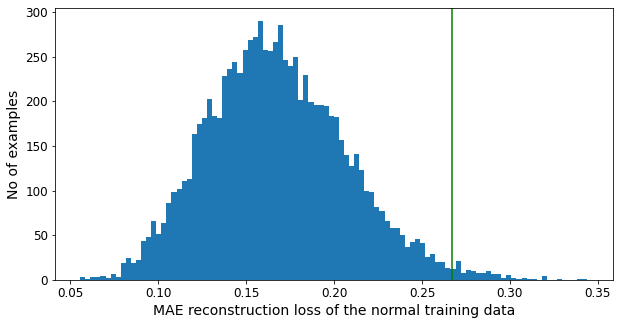

Mean:  0.16785361
Std:  0.039581914
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.26680839248001575


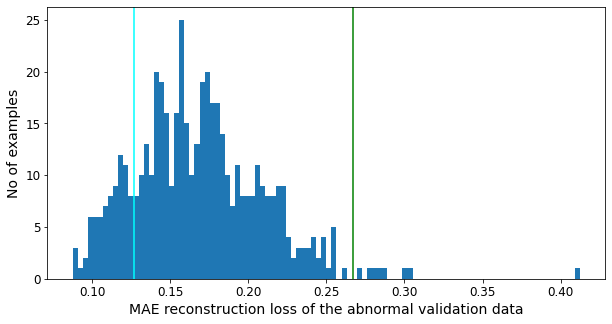

Threshold2:  0.12686405


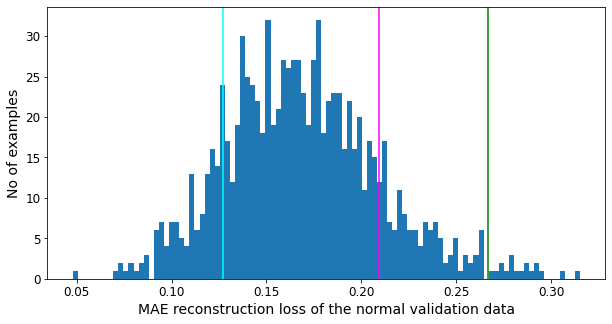

Threshold3:  0.20955116
Average of threshold 2 and 3:  0.16820760071277618
The best threshold based on validation data:  0.168335265517235


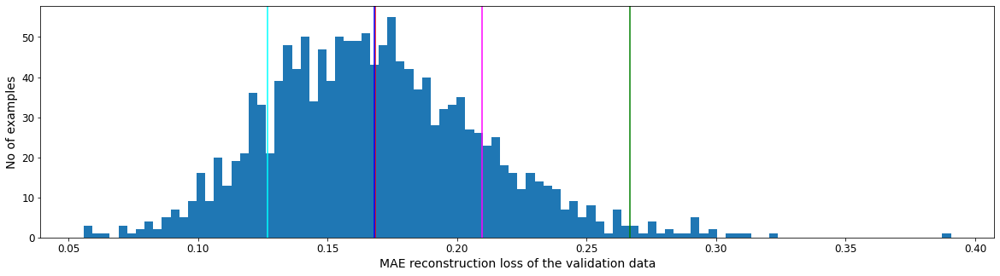

Confusion Matrix: 
 prediction: F      T 
             1403   1597
 label: F   [[467   533]    1000
        T    [936   1064]]   2000
Accuracy = 0.5103333333333333
Normal Test Data Mean = 0.16892419755458832
Normal Test Data Standard Deviation = 0.04017239063978195
Abnormal Test Data Mean = 0.1665298193693161
Abnormal Test Data Standard Deviation = 0.03988077864050865
Precision = 0.6662492172824045
Recall = 0.532
Threshold = 0.168335265517235
[[ 467  533]
 [ 936 1064]]
Extra results with different thresholds
Confusion Matrix: 
 prediction: F      T 
             1456   1544
 label: F   [[465   535]    1000
        T    [991   1009]]   2000
Accuracy = 0.49133333333333334
Normal Test Data Mean = 0.16892419755458832
Normal Test Data Standard Deviation = 0.04017239063978195
Abnormal Test Data Mean = 0.1665298193693161
Abnormal Test Data Standard Deviation = 0.03988077864050865
Precision = 0.6534974093264249
Recall = 0.5045
Confusion Matrix: 
 prediction: F      T 
             49   2951
 l

In [8]:
normals = [3,5] # cat, dog
abnormals = [0] # airplane
res5 = run_experiments(normals, abnormals)

1 out of 3
Epoch 1/100
211/211 [==============================] - 30s 126ms/step - loss: 0.5229 - val_loss: 0.5218
Epoch 2/100
211/211 [==============================] - 25s 118ms/step - loss: 0.5166 - val_loss: 0.5108
Epoch 3/100
211/211 [==============================] - 25s 120ms/step - loss: 0.5110 - val_loss: 0.5077
Epoch 4/100
211/211 [==============================] - 25s 119ms/step - loss: 0.5078 - val_loss: 0.5044
Epoch 5/100
211/211 [==============================] - 26s 121ms/step - loss: 0.5053 - val_loss: 0.5035
Epoch 6/100
211/211 [==============================] - 20s 95ms/step - loss: 0.5039 - val_loss: 0.5109
Epoch 7/100
211/211 [==============================] - 20s 95ms/step - loss: 0.5033 - val_loss: 0.5038
Epoch 8/100
211/211 [==============================] - 20s 95ms/step - loss: 0.5028 - val_loss: 0.5040
Epoch 9/100
211/211 [==============================] - 20s 96ms/step - loss: 0.5025 - val_loss: 0.5051
Epoch 10/100
211/211 [==============================] - 2

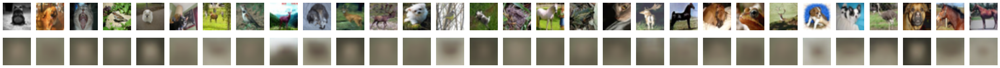

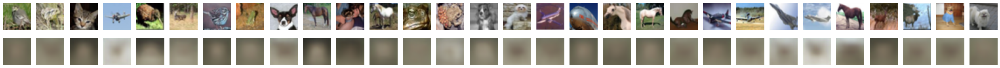

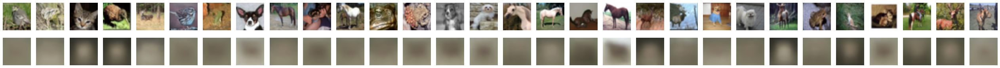

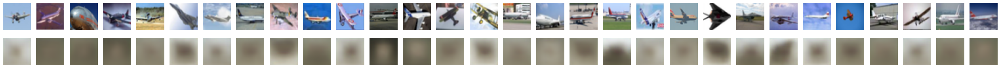

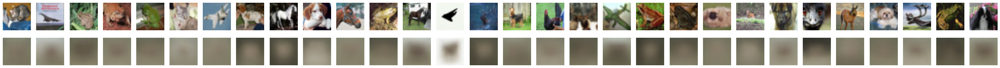

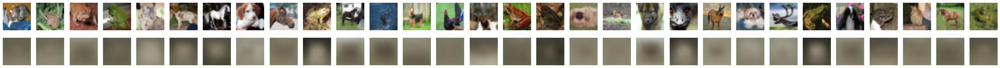

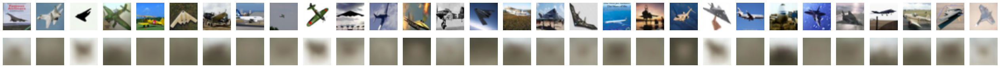

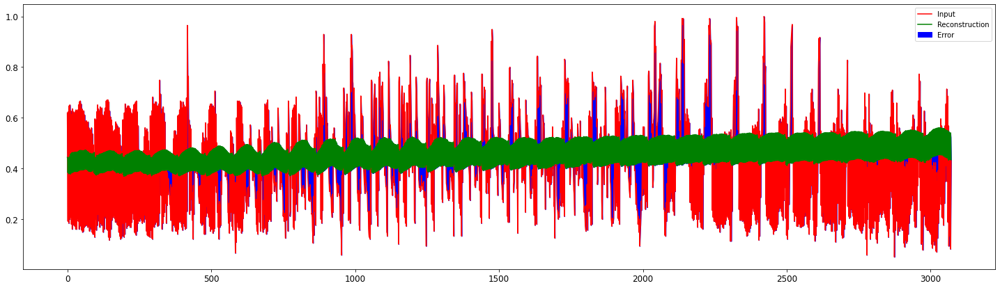

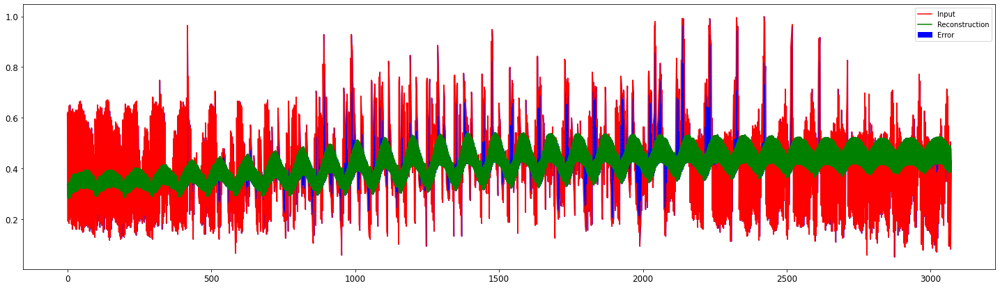

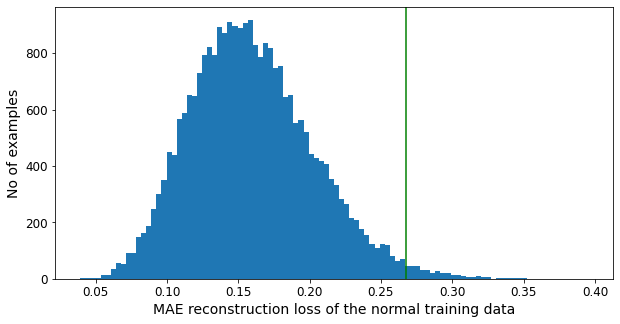

Mean:  0.15969144
Std:  0.04317565
Threshold based on the mean of the training data MAE reconstruction losses + 2.5 std:  0.267630560323596


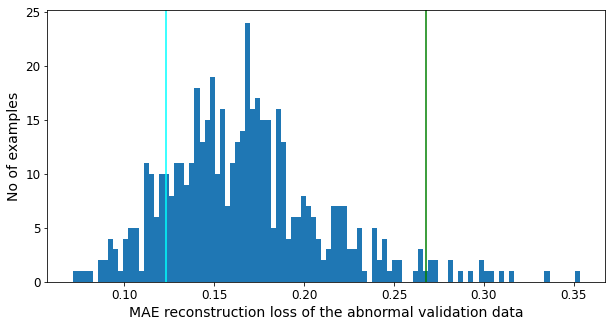

Threshold2:  0.12351604


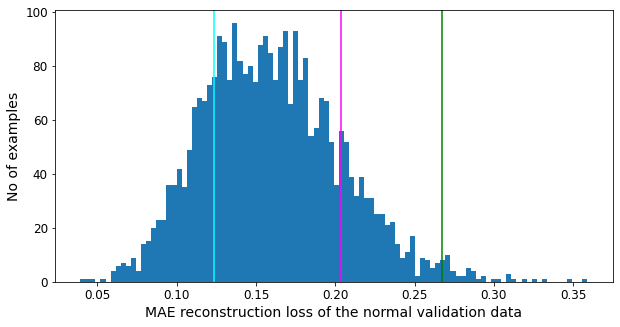

Threshold3:  0.20332137
Average of threshold 2 and 3:  0.163418710231781
The best threshold based on validation data:  0.16732908755540815


In [ ]:
normals = [2,3,4,5,6,7] # animals
abnormals = [0] # airplane
res6 = run_experiments(normals, abnormals)

In [ ]:
normals = [0,1,8,9] # transportation
abnormals = [2] # bird
res7 = run_experiments(normals, abnormals)